<a href="https://colab.research.google.com/github/lidiavale/PDSI-BIA202401-E01/blob/main/Notebook_PDSI_BIA202401_E01.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Importação das bibliotecas e Dataset

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import librosa
import librosa.display

In [2]:
#Importação do .csv que traz as informações gerais sobre todos os arquivos de áudio que tem no dataset
df = pd.read_csv('features_30_sec.csv')

In [3]:
df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


#Exploração dos dados

In [4]:
#Contagem de quantas músicas de cada label
df['label'].value_counts()

,count
label,
blues,100
classical,100
country,100
disco,100
hiphop,100
jazz,100
metal,100
pop,100
reggae,100


##Analisar as ondas sonoras de cada áudio usando a biblioteca Librosa


In [5]:
from IPython.display import Audio
import os

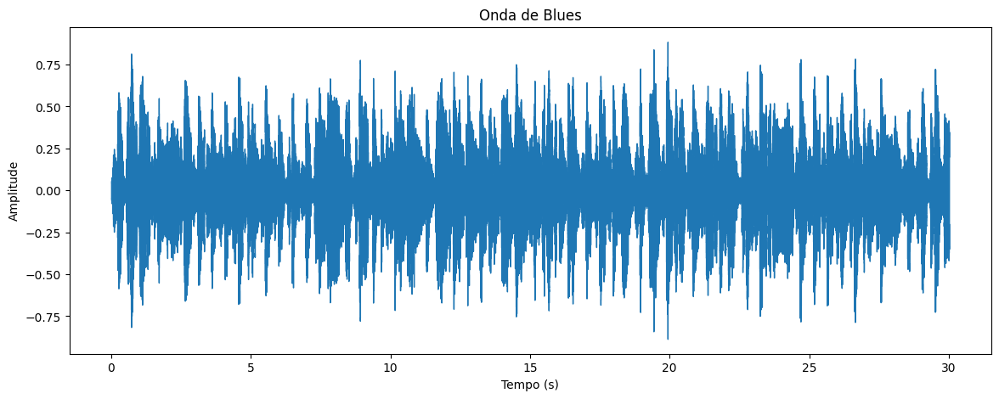

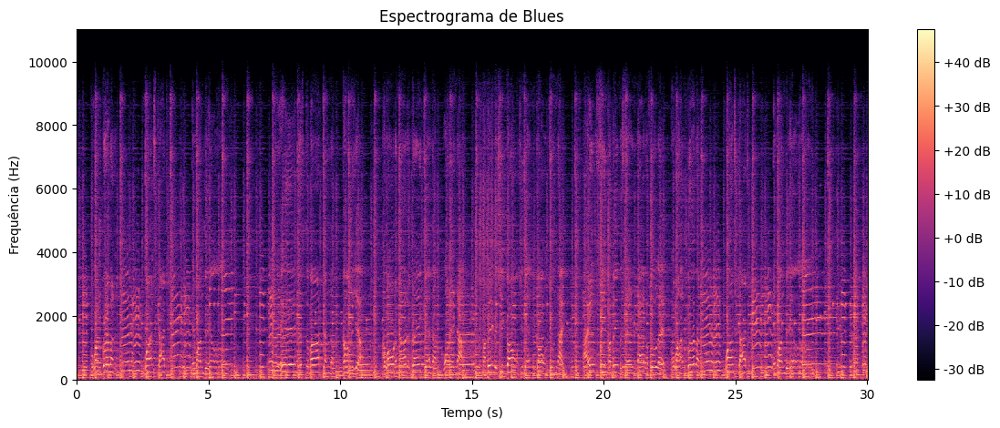

-----------------



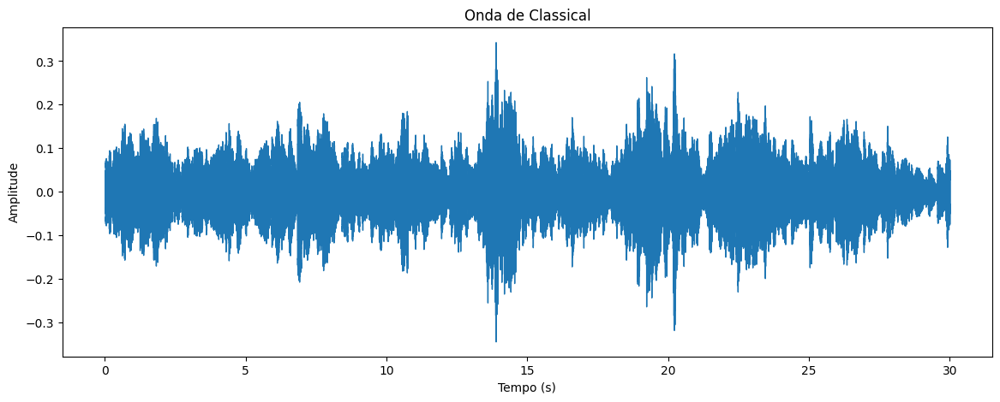

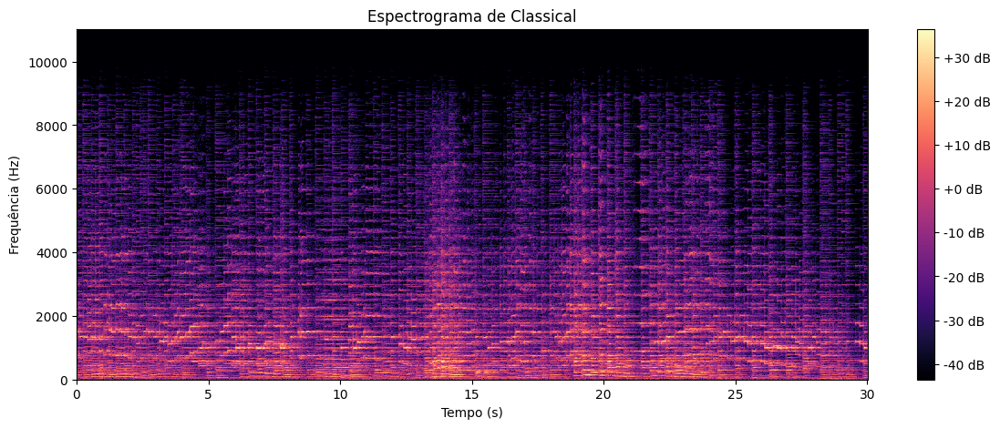

-----------------



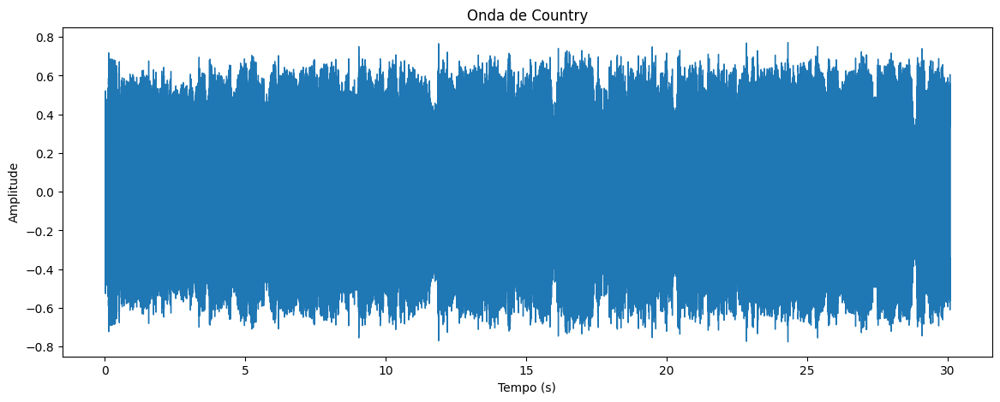

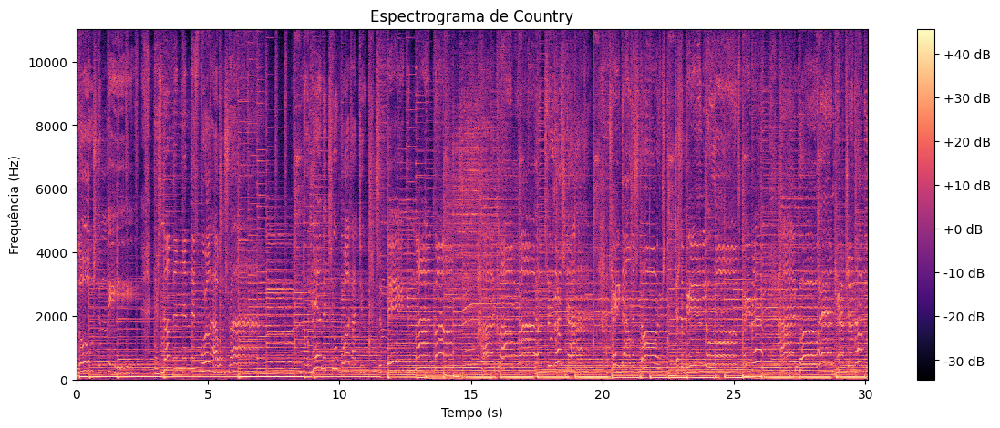

-----------------



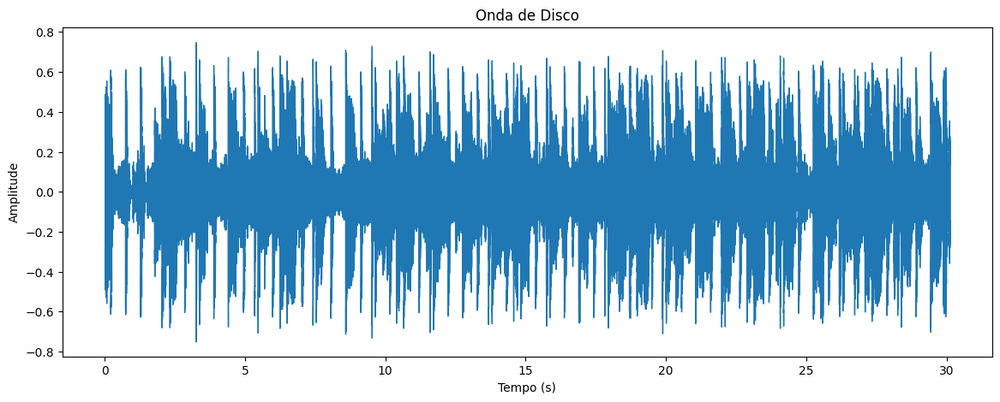

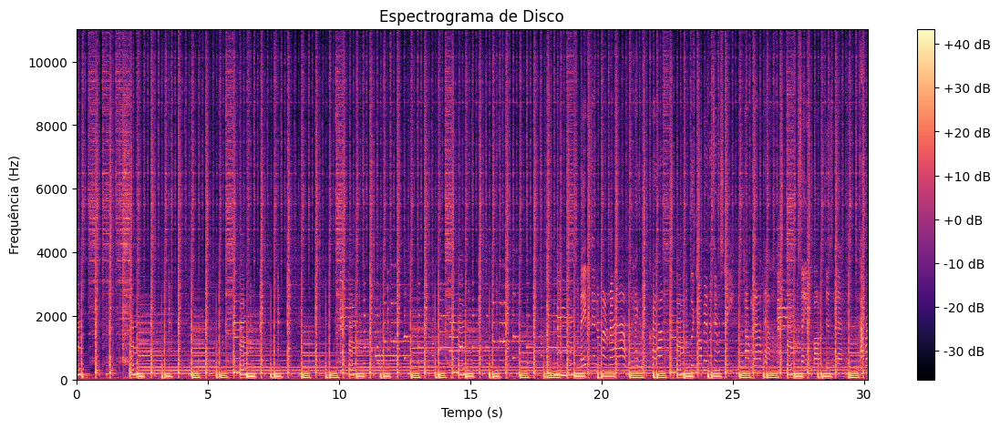

-----------------



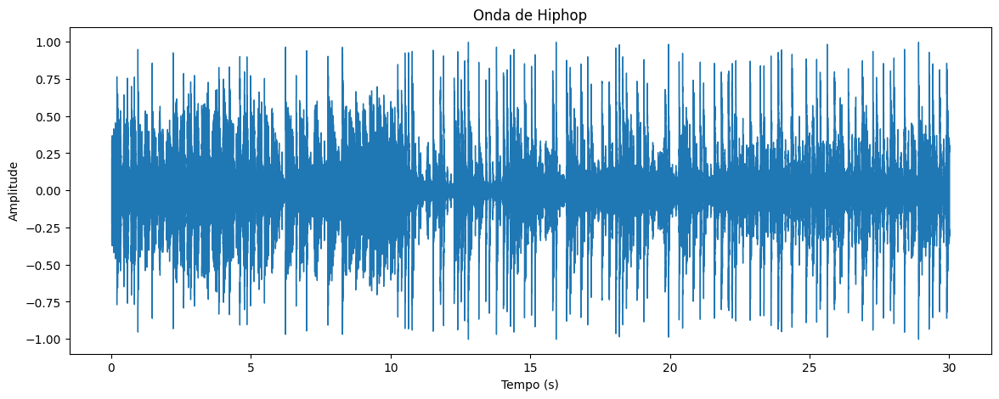

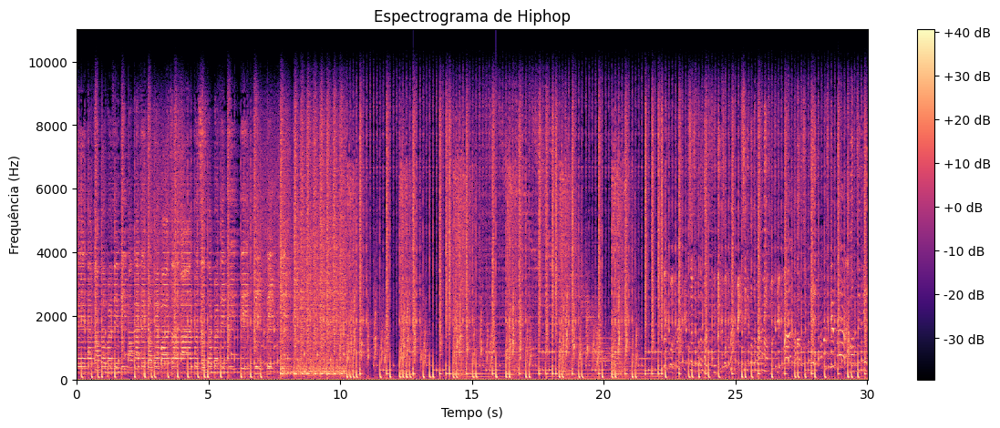

-----------------



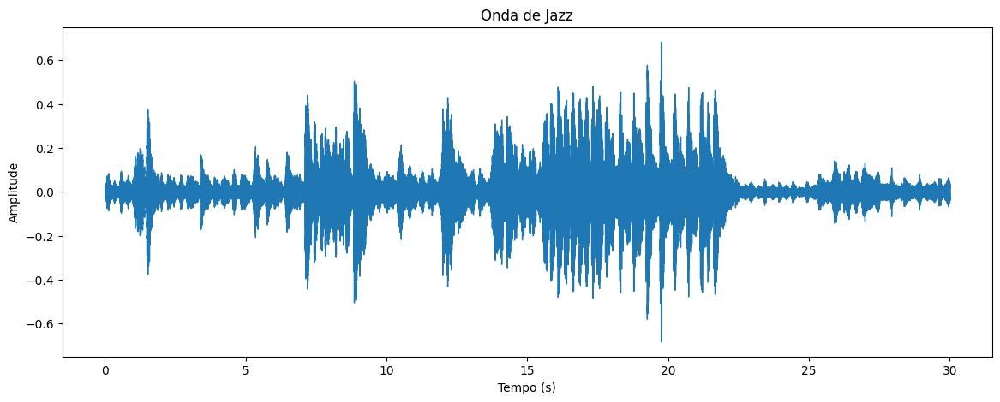

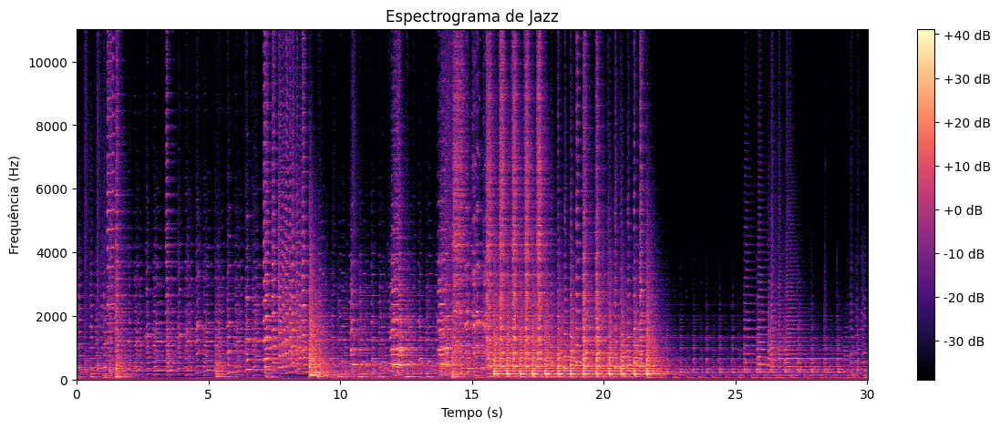

-----------------



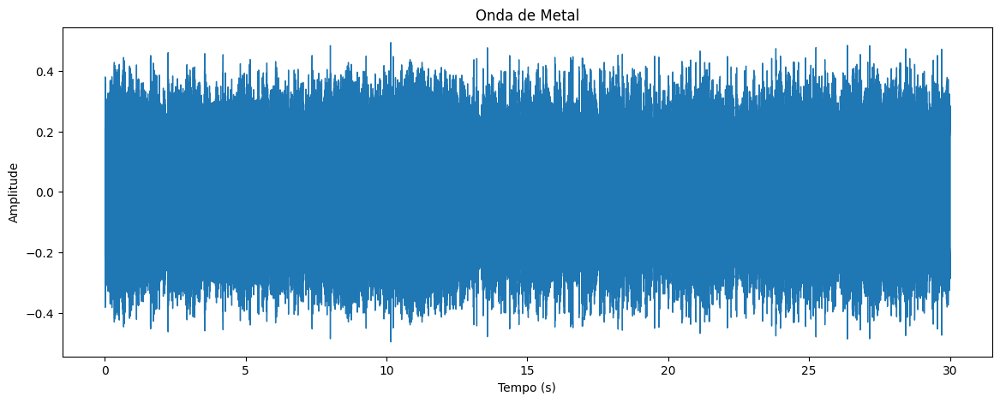

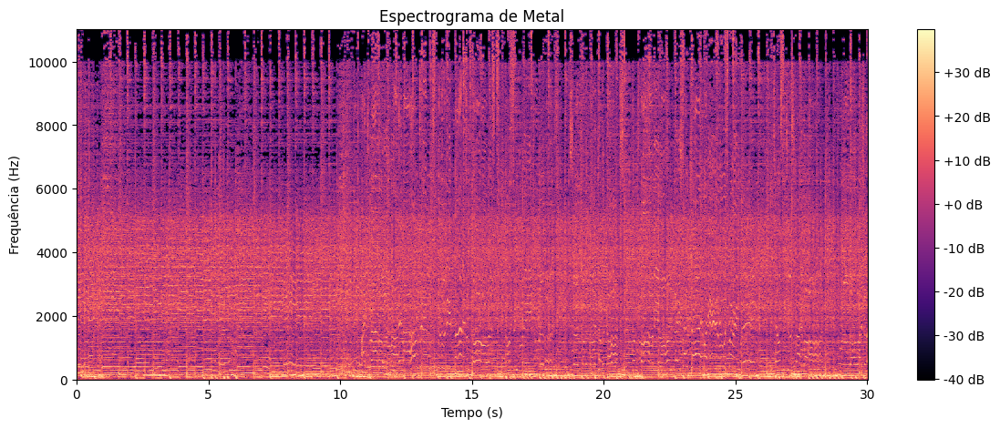

-----------------



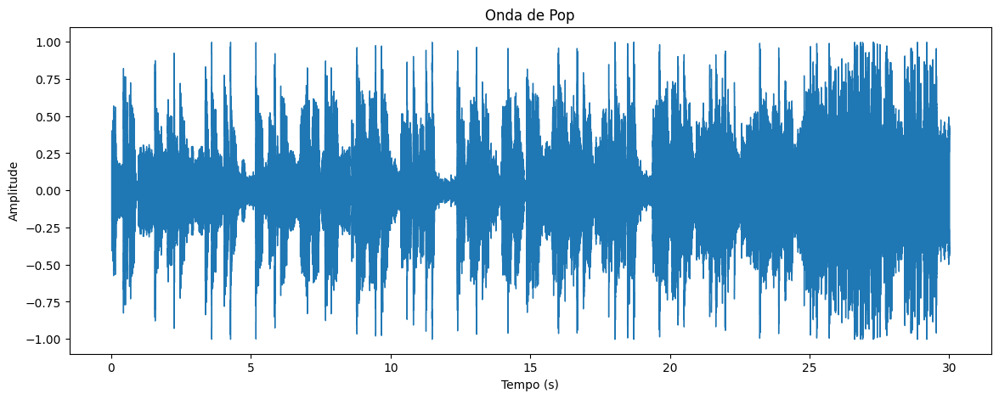

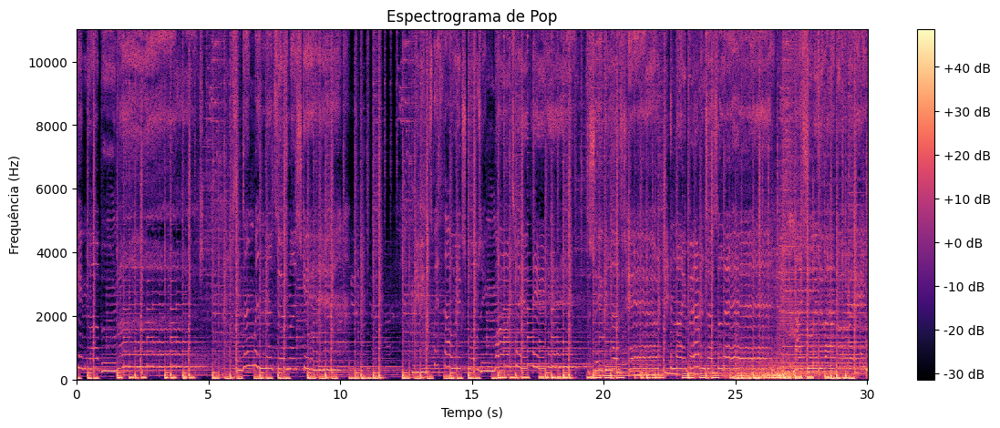

-----------------



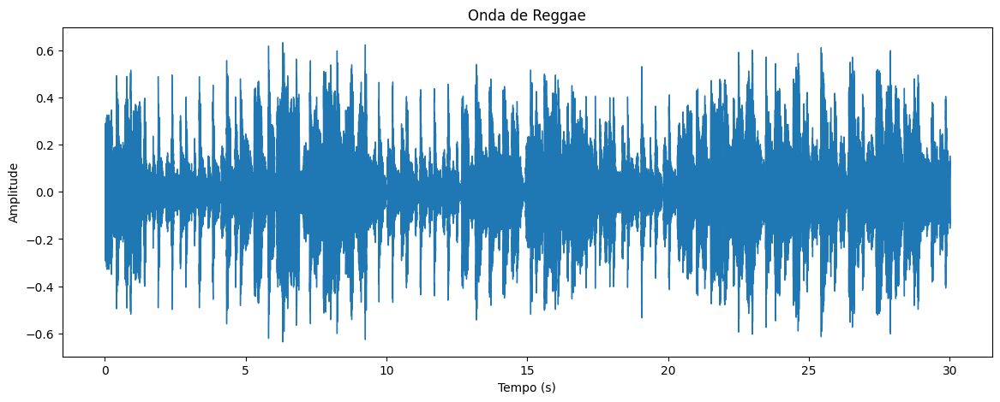

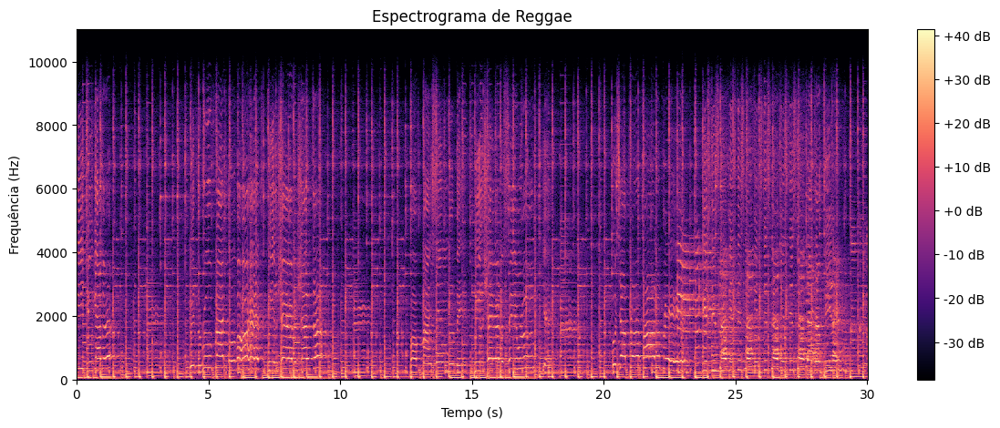

-----------------



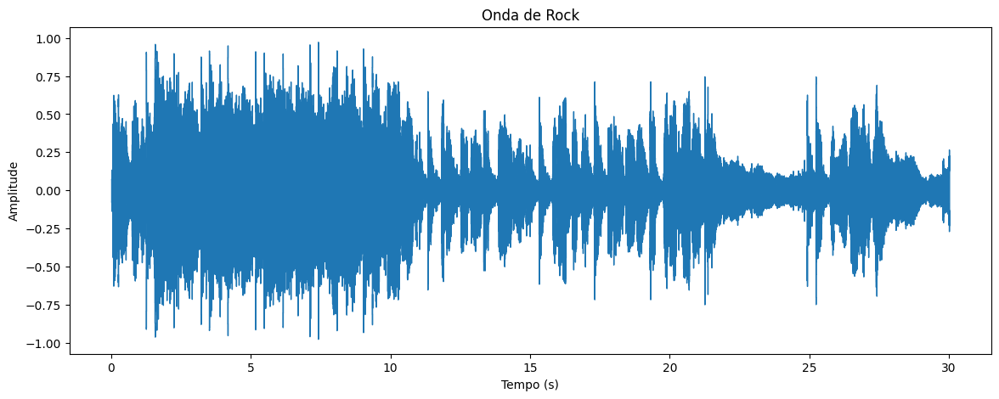

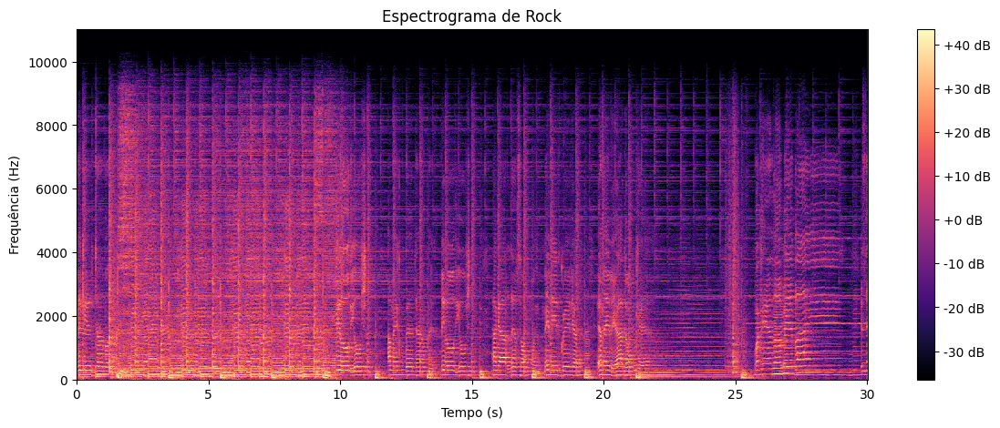

-----------------



In [26]:
# Lista dos gêneros
genres = ["blues", "classical", "country", "disco", "hiphop", "jazz", "metal", "pop", "reggae", "rock"]

# Base path onde os arquivos estão armazenados
base_path = ""

# Iterar sobre os gêneros
for genre in genres:
    path = os.path.join(base_path, f"{genre}.00000.wav")  # Nome do arquivo correspondente ao gênero

    if os.path.exists(path):
        # Carregar o arquivo de áudio
        x, sr = librosa.load(path)

        # Plotar o gráfico da onda
        plt.figure(figsize=(14, 5))
        librosa.display.waveshow(x, sr=sr)
        plt.title(f"Onda de {genre.capitalize()}")
        plt.xlabel("Tempo (s)")
        plt.ylabel("Amplitude")
        plt.show()

        # Plotar o espectrograma
        X = librosa.stft(x)  # Transformada de Fourier no sinal
        X_db = librosa.amplitude_to_db(abs(X))  # Converte para escala logarítmica
        plt.figure(figsize=(14, 5))
        librosa.display.specshow(X_db, sr=sr, x_axis='time', y_axis='hz', cmap='magma')
        plt.colorbar(format='%+2.0f dB')
        plt.title(f"Espectrograma de {genre.capitalize()}")
        plt.xlabel("Tempo (s)")
        plt.ylabel("Frequência (Hz)")
        plt.show()

        # Reproduzir o áudio
        display(Audio(path))
        print("-----------------\n")
    else:
        print(f"Arquivo {path} não encontrado.")

##Matriz de correlação

Código a seguir:

Em resumo, o código faz o seguinte:

- Seleciona as colunas do DataFrame que representam valores médios.
- Calcula a matriz de correlação entre essas colunas.
- Plota a matriz de correlação como um mapa de calor usando o Seaborn.
- Define o título do gráfico e o tamanho da fonte dos rótulos dos eixos.

O mapa de calor gerado permite visualizar a correlação entre as diferentes características dos áudios, especificamente as que são representadas por valores médios. Cores mais claras indicam correlação positiva mais forte, cores mais escuras indicam correlação negativa mais forte. Isso ajuda na análise exploratória dos dados, identificando quais características tendem a variar juntas.

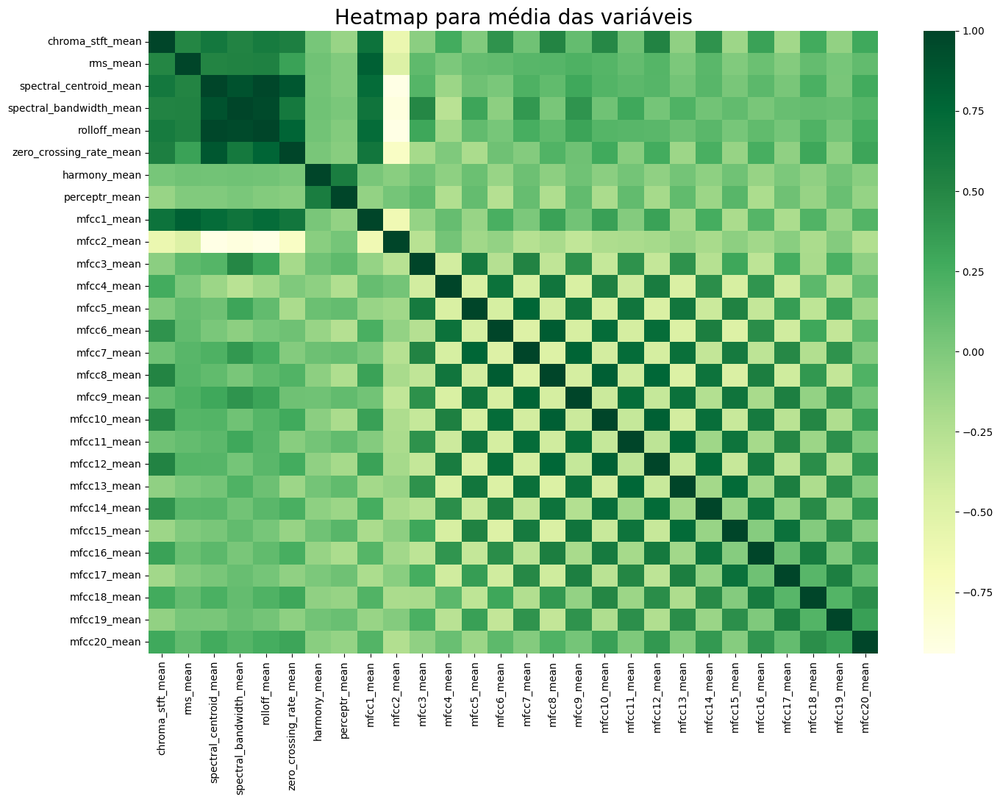

In [7]:
# Calculando a Matriz de Correlação
# Se o nome da coluna contiver a palavra 'mean' (média de alguma característica do áudio), ela é adicionada à lista spike_cols.
spike_cols = [col for col in df.columns if 'mean' in col]

# Configurar a figura do matplotlib
f, ax = plt.subplots(figsize=(16, 11));

# Gerar o mapa de calor (heatmap) com a máscara e a proporção correta
# Calcula a matriz de correlação entre as colunas selecionadas em spike_cols
sns.heatmap(df[spike_cols].corr(), cmap='YlGn')

plt.title('Heatmap para média das variáveis', fontsize=20)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10);

#Pré-processamento dos dados

In [8]:
#LabelEncoder() para converter os labels em números inteiros
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df['label'] = label_encoder.fit_transform(df['label'])

In [9]:
#Remover coluna de "filename" (não é relevante)
X = df.drop(['filename', 'label'], axis=1)
y = df['label']

In [10]:
#Escalar os dados (deixa o modelo mais estável e rápido), usando Normalização (Min-Max Scaling)
from sklearn import preprocessing
cols = X.columns
minmax = preprocessing.MinMaxScaler()
np_scaled = minmax.fit_transform(X)

#Criar novo dataframe com os dados escalados
X = pd.DataFrame(np_scaled, columns = cols)

#Treinamento do Modelo

In [11]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=111)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((700, 58), (300, 58), (700,), (300,))

##Teste nos modelos:

- Random Forest: O RandomForestClassifier ajusta várias árvores de decisão em diferentes subconjuntos do conjunto de dados e utiliza a média para melhorar os resultados.
- CatBoost: O CatBoost implementa árvores de decisão e restringe a divisão de recursos por nível a apenas um, o que ajuda a reduzir o tempo de previsão. Ele também lida efetivamente com características categóricas.
- Gradient Boost: No Gradient Boost, árvores de decisão são implementadas de forma sequencial, o que melhora o desempenho.

In [12]:
!pip install catboost

In [13]:
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier
import catboost as cb
from xgboost import XGBClassifier

In [14]:
rf = RandomForestClassifier(n_estimators=1000, max_depth=10, random_state=0)
cbc = cb.CatBoostClassifier(verbose=0, eval_metric='Accuracy', loss_function='MultiClass')
xgb = XGBClassifier(n_estimators=1000, learning_rate=0.05)

RandomForestClassifier:
  Accuracy = 0.7800
  F1-Score (Macro) = 0.7769
  Precisão Top-3 = 0.9600
------------------------------


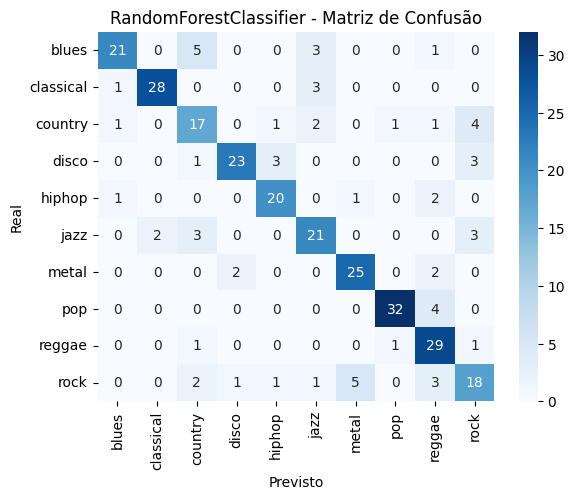

CatBoostClassifier:
  Accuracy = 0.8333
  F1-Score (Macro) = 0.8312
  Precisão Top-3 = 0.9633
------------------------------


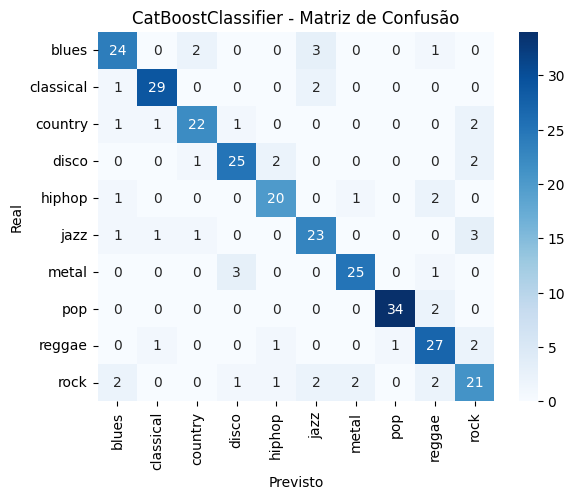

XGBClassifier:
  Accuracy = 0.7833
  F1-Score (Macro) = 0.7820
  Precisão Top-3 = 0.9567
------------------------------


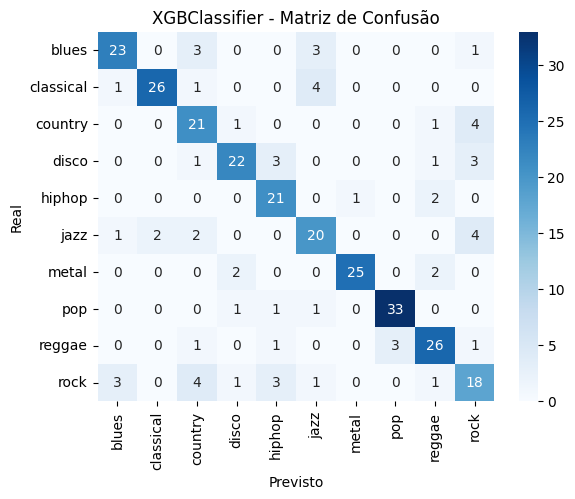


Resumo das Métricas por Modelo:
                Modelo  Accuracy  F1-Score (Macro)  Top-3 Accuracy
RandomForestClassifier  0.780000          0.776917        0.960000
    CatBoostClassifier  0.833333          0.831220        0.963333
         XGBClassifier  0.783333          0.782021        0.956667


In [16]:
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix

# Lista para armazenar os resultados
results = []

# Converter y_test em array numpy, se necessário
if hasattr(y_test, 'values'):
    y_test = y_test.values

for clf in (rf, cbc, xgb):
    clf.fit(X_train, y_train)
    preds = clf.predict(X_test)
    probs = clf.predict_proba(X_test)

    # Calcular as métricas
    accuracy = accuracy_score(y_test, preds)
    f1_macro = f1_score(y_test, preds, average='macro')

    # Precisão Top-3
    top_n = 3
    top_preds = np.argsort(probs, axis=1)[:, -top_n:]
    top_n_accuracy = np.mean([y_test[i] in top_preds[i] for i in range(len(y_test))])  # Calcula precisão Top-N

    # Exibir métricas
    print(f"{clf.__class__.__name__}:")
    print(f"  Accuracy = {accuracy:.4f}")
    print(f"  F1-Score (Macro) = {f1_macro:.4f}")
    print(f"  Precisão Top-{top_n} = {top_n_accuracy:.4f}")
    print("-" * 30)

    # Adicionar os resultados na lista
    results.append({
        "Modelo": clf.__class__.__name__,
        "Accuracy": accuracy,
        "F1-Score (Macro)": f1_macro,
        f"Top-{top_n} Accuracy": top_n_accuracy
    })

    # Matriz de Confusão
    cm = confusion_matrix(y_test, preds)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=genres, yticklabels=genres)
    plt.title(f"{clf.__class__.__name__} - Matriz de Confusão")
    plt.xlabel("Previsto")
    plt.ylabel("Real")
    plt.show()

# Criar o DataFrame com os resultados
results_df = pd.DataFrame(results)

# Exibir a tabela com o resumo das métricas
print("\nResumo das Métricas por Modelo:")
print(results_df.to_string(index=False))

#Rede neural: avaliar o dataset usando rede neural simples

In [17]:
import tensorflow.keras as keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import *

In [18]:
model = Sequential()

model.add(Flatten(input_shape=(58,)))
model.add(Dense(256, activation='relu'))
model.add(BatchNormalization())
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.3))
model.add(Dense(10, activation='softmax'))
model.summary()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ flatten (Flatten)                    │ (None, 58)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │          15,104 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 10)                  │           1,290 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 50,314 (196.54 KB)

 Trainable params: 49,802 (194.54 KB)

 Non-trainable params: 512 (2.00 KB)

In [19]:
# Compilar o modelo
adam = keras.optimizers.Adam(learning_rate=1e-4)
model.compile(optimizer=adam,
             loss="sparse_categorical_crossentropy",
             metrics=["accuracy"])
hist = model.fit(X_train, y_train, epochs=100, batch_size = 32, validation_data=(X_test, y_test))

Epoch 1/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.1075 - loss: 2.5431 - val_accuracy: 0.1267 - val_loss: 2.2862
Epoch 2/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.1947 - loss: 2.2761 - val_accuracy: 0.1767 - val_loss: 2.2535
Epoch 3/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.2844 - loss: 2.0265 - val_accuracy: 0.2300 - val_loss: 2.2186
Epoch 4/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.3770 - loss: 1.8112 - val_accuracy: 0.2700 - val_loss: 2.1871
Epoch 5/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.3963 - loss: 1.6932 - val_accuracy: 0.3133 - val_loss: 2.1541
Epoch 6/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.4608 - loss: 1.6449 - val_accuracy: 0.3367 - val_loss: 2.1182
Epoch 7/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.4463 - loss: 1.6071 - val_accuracy: 0.3767 - val_loss: 2.0789
Epoch 8/100
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.4613 - loss: 1.5161 - val_accuracy: 0.4267 - 

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7844 - loss: 0.6865 
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 

Classification Report - Rede Neural Simples:
              precision    recall  f1-score   support

       blues       0.74      0.57      0.64        30
   classical       0.91      0.97      0.94        32
     country       0.65      0.74      0.69        27
       disco       0.76      0.63      0.69        30
      hiphop       0.83      0.83      0.83        24
        jazz       0.85      0.76      0.80        29
       metal       0.79      0.90      0.84        29
         pop       0.86      0.86      0.86        36
      reggae       0.69      0.78      0.74        32
        rock       0.59      0.61      0.60        31

    accuracy                           0.77       300
   macro avg       0.77      0.77      0.76       300
weighted avg       0.77      0.77      0.76       300



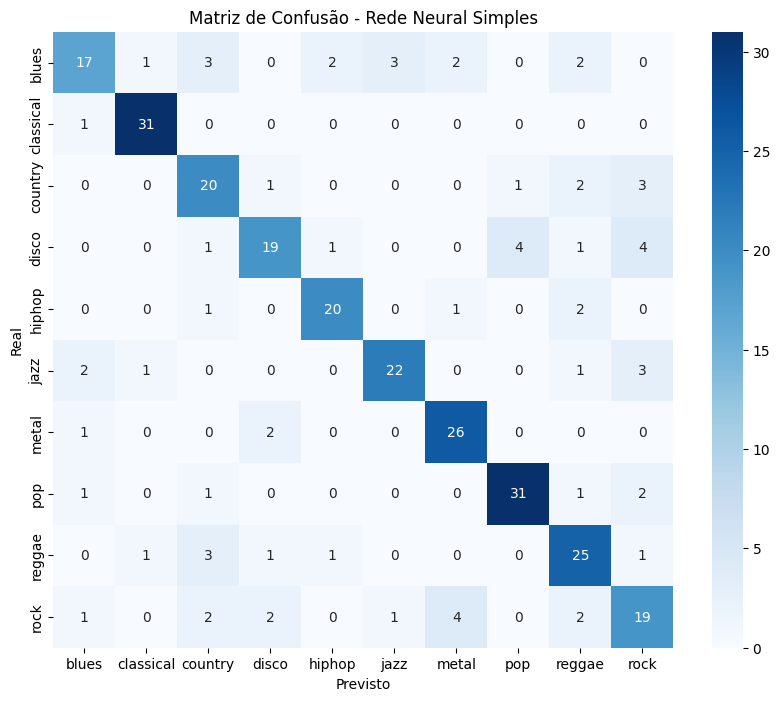


Resumo das Métricas - Rede Neural Simples:
             Modelo  NN Accuracy  NN F1-Score (Macro)  NN Top-3 Accuracy
Rede Neural Simples     0.766667             0.763309           0.946667


In [22]:
from sklearn.metrics import classification_report

# Avaliar o modelo no conjunto de teste
test_loss, test_accuracy = model.evaluate(X_test, y_test, verbose=1)

# Fazer previsões
probs = model.predict(X_test)  # Probabilidades preditas
preds = np.argmax(probs, axis=1)  # Classes preditas
true_labels = y_test  # Classes reais já estão em formato inteiro para sparse_categorical_crossentropy

# Calcular métricas adicionais
nn_accuracy = test_accuracy
nn_f1_macro = f1_score(true_labels, preds, average='macro')

# Relatório de classificação
print("\nClassification Report - Rede Neural Simples:")
print(classification_report(true_labels, preds, target_names=genres))

# Matriz de Confusão
cm = confusion_matrix(true_labels, preds)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=genres, yticklabels=genres)
plt.title("Matriz de Confusão - Rede Neural Simples")
plt.xlabel("Previsto")
plt.ylabel("Real")
plt.show()

# Calcular Precisão Top-3
top_n = 3
top_preds = np.argsort(probs, axis=1)[:, -top_n:]
nn_top_n_accuracy = np.mean([true_labels[i] in top_preds[i] for i in range(len(true_labels))])

# Adicionar resultados em um dicionário
nn_results = [{
    "Modelo": "Rede Neural Simples",
    "NN Accuracy": nn_accuracy,
    "NN F1-Score (Macro)": nn_f1_macro,
    f"NN Top-{top_n} Accuracy": nn_top_n_accuracy
}]

# Criar DataFrame com os resultados
nn_results_df = pd.DataFrame(nn_results)

# Exibir a tabela de resumo
print("\nResumo das Métricas - Rede Neural Simples:")
print(nn_results_df.to_string(index=False))

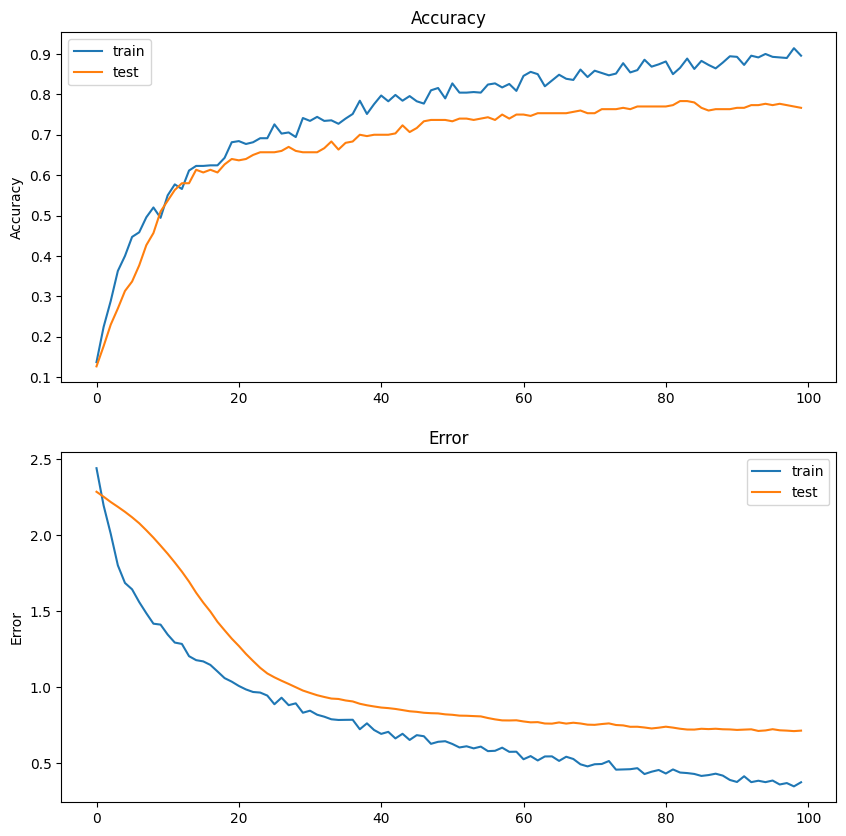

In [23]:
fig, axs = plt.subplots(2,figsize=(10,10))

# accuracy
axs[0].plot(hist.history["accuracy"], label="train")
axs[0].plot(hist.history["val_accuracy"], label="test")
axs[0].set_ylabel("Accuracy")
axs[0].legend()
axs[0].set_title("Accuracy")

# Error
axs[1].plot(hist.history["loss"], label="train")
axs[1].plot(hist.history["val_loss"], label="test")
axs[1].set_ylabel("Error")
axs[1].legend()
axs[1].set_title("Error")

plt.show()